# 1. Helpers

In [ ]:
import numpy as np
import os, shutil

In [ ]:
class Helper():
  def unnormalize(self, img, mean, std):
    normal_image = img.detach().cpu()
    normal_image = normal_image.numpy().transpose((1,2,0))
    normal_image = std * normal_image + mean
    normal_image = np.clip(normal_image, 0, 1)
    return normal_image
  
  def create_dir(self, dir):
    if not os.path.isdir(dir):
      os.mkdir(dir)
    elif len(os.listdir(dir)) > 0:
      shutil.rmtree(dir)
      os.mkdir(dir)

  def display_images(self, X, num_examples, pixel_mean, pixel_std, show_labels=False, labels=[], y=[], save_fig=False, fig_name=""):
    figure = plt.figure(figsize=(10,10))

    for i in range(num_examples):
      plt.subplot(6,6,i+1)
      normal_image = self.unnormalize(X[i], pixel_mean, pixel_std)
      plt.imshow(normal_image, aspect="auto")
      plt.axis("off")

      if show_labels:
        plt.title(labels[y[i]].split("-")[1])

    plt.tight_layout()
    if save_fig:
      plt.savefig(fig_name)
    plt.show()

In [ ]:
helper = Helper()

# 2. Dataset

In [ ]:
from torchvision import datasets, transforms
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt

In [ ]:
class Dataset():
  def __init__(self, root_dir, img_size, batch_size, pixel_mean, pixel_std):
    self.root_dir = root_dir
    self.img_size = img_size
    self.batch_size = batch_size
    self.pixel_mean = pixel_mean
    self.pixel_std = pixel_std
  
  def _download_dataset(self):
    if os.path.isdir(self.root_dir):
      return

    !rm -fr sample_data
    print("Downloading dataset...")
    !wget http://vision.stanford.edu/aditya86/ImageNetDogs/images.tar -q
    print("Unzipping dataset...")
    !tar -xf images.tar
    os.rename("Images", self.root_dir)
  
  def _get_tfms(self):
    transformations = transforms.Compose([
        transforms.Resize(self.img_size),
        transforms.CenterCrop(self.img_size),
        transforms.ToTensor(),
        transforms.Normalize(mean=self.pixel_mean, std=self.pixel_std)
    ])
  
    return transformations

  def get_dataset(self):
    self._download_dataset()
    print("Creating datasets...")
    transformations = self._get_tfms()
    train_ds = datasets.ImageFolder(root=self.root_dir, transform=transformations)
    labels = train_ds.classes
    print("Done!")
    return train_ds, labels
  
  def load_dataset(self, ds):
    dl = DataLoader(ds, batch_size=self.batch_size, shuffle=True)
    return dl

In [ ]:
ROOT_DIR = "dataset"
IMG_SIZE = 64
BATCH_SIZE = 128
PIXEL_MEAN = (0.5,0.5,0.5)
PIXEL_STD = (0.5,0.5,0.5)
     

data = Dataset(ROOT_DIR, IMG_SIZE, BATCH_SIZE, PIXEL_MEAN, PIXEL_STD)

In [ ]:
train_ds, labels = data.get_dataset()
train_dl = data.load_dataset(train_ds)

Unzipping dataset...
Creating datasets...
Done!


In [ ]:
print(f"{len(labels)} labels with {len(train_ds)} images of different dog breeds")

120 labels with 20580 images of different dog breeds


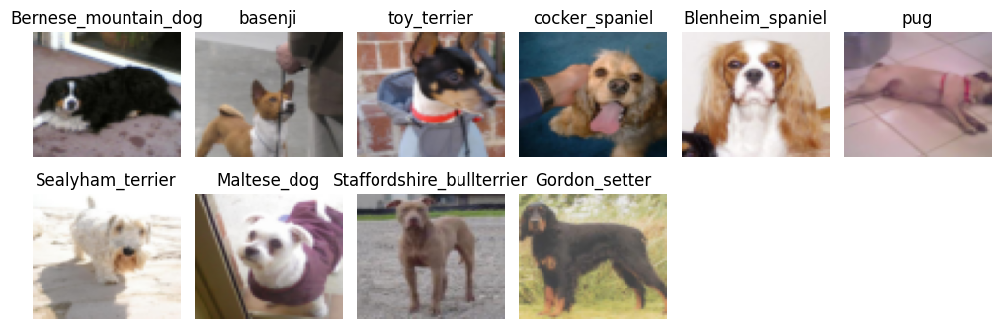

In [ ]:
X, y = next(iter(train_dl))
helper.display_images(X=X, num_examples=10, pixel_mean=PIXEL_MEAN, pixel_std=PIXEL_STD, show_labels=True, labels=labels, y=y)

# 3. Neural Networks
We will have two Neural Networks, the generator which takes in a random latent vector and gives back an image, the discriminator which takes the output image by the generator and tells us how fake the discriminator is.

In [ ]:
import torch
from torch import nn

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cuda')

## 3.1 Generator

In [ ]:
LATENT_V = 128

In [ ]:
class Generator(nn.Module):
  def __init__(self):
    super().__init__()

    self.main = nn.Sequential(
        nn.ConvTranspose2d(LATENT_V, 512, kernel_size=4, stride=2, padding=0, bias=False),
        nn.BatchNorm2d(512),
        nn.ReLU(True),
        # Out: 512, 4, 4

        nn.ConvTranspose2d(512, 256, kernel_size=4, stride=2, padding=1, bias=False),
        nn.BatchNorm2d(256),
        nn.ReLU(True),
        # Out: 256, 8, 8

        nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1, bias=False),
        nn.BatchNorm2d(128),
        nn.ReLU(True),
        # Out: 128, 16, 16

        nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1, bias=False),
        nn.BatchNorm2d(64),
        nn.ReLU(True),
        # Out: 64, 32, 32

        nn.ConvTranspose2d(64, 3, kernel_size=4, stride=2, padding=1, bias=False),
        nn.Tanh()
        # Out: 3, 64, 64
    )
  
  def forward(self, input):
    return self.main(input)

In [ ]:
generator = Generator().to(device)
latent = torch.randn(BATCH_SIZE, LATENT_V, 1, 1, device=device)
fake_images = generator(latent)
fake_images.shape, fake_images[5].shape

(torch.Size([128, 3, 64, 64]), torch.Size([3, 64, 64]))

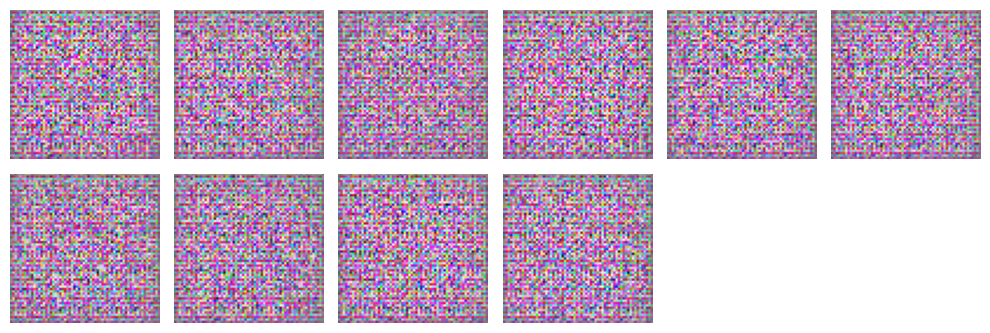

In [ ]:
helper.display_images(fake_images, 10, PIXEL_MEAN, PIXEL_STD)

## 3.2 Discriminator

In [ ]:
class Discriminator(nn.Module):
  def __init__(self):
    super().__init__()

    self.main = nn.Sequential(
        nn.Conv2d(3, 64, kernel_size=4, stride=2, padding=1, bias=False),
        nn.BatchNorm2d(64),
        nn.LeakyReLU(0.2, inplace=True),
        # Out: 64, 32, 32

        nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1, bias=False),
        nn.BatchNorm2d(128),
        nn.LeakyReLU(0.2, inplace=True),
        # Out: 128, 16, 16

        nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1, bias=False),
        nn.BatchNorm2d(256),
        nn.LeakyReLU(0.2, inplace=True),
        # Out: 256, 8, 8

        nn.Conv2d(256, 512, kernel_size=4, stride=2, padding=1, bias=False),
        nn.BatchNorm2d(512),
        nn.LeakyReLU(0.2, inplace=True),
        # Out: 512, 4, 4

        nn.Conv2d(512, 1, kernel_size=4, stride=1, padding=0, bias=False),
        # out: 1, 1, 1

        nn.Flatten(),
        nn.Sigmoid()
    )

  def forward(self, input):
    return self.main(input)

In [ ]:
discriminator = Discriminator().to(device)
decision = discriminator(fake_images)
decision.shape

torch.Size([128, 1])

# 4. Trainer
We will have three functions: train_generator (to train the generator), train_discriminator: (to train the discriminator), fit (to train both of them simultaniously)

In [ ]:
from tqdm.notebook import tqdm
from google.colab import files

In [ ]:
class Trainer():
  def __init__(self, optim_g, optim_d, generator, discriminator, pixel_mean, pixel_std):
    self.optim_g, self.optim_d, self.generator, self.discriminator, self.pixel_mean, self.pixel_std = optim_g, optim_d, generator, discriminator, pixel_mean, pixel_std

  def _train_generator(self):
    self.optim_g.zero_grad()

    # Generate fake images
    latent = torch.randn(BATCH_SIZE, LATENT_V, 1, 1, device=device)
    fake_images = self.generator(latent)

    # Get loss on fake images
    output = self.discriminator(fake_images)
    targets = torch.ones(BATCH_SIZE, 1, device=device)
    loss = F.binary_cross_entropy(output, targets)

    # Update weights
    loss.backward()
    self.optim_g.step()
    return loss.item()
  
  def _train_discriminator(self, real_images):
    self.optim_d.zero_grad()

    # Get loss on real images
    real_output = self.discriminator(real_images)
    real_targets = torch.ones(real_output.shape[0], 1, device=device)
    real_loss = F.binary_cross_entropy(real_output, real_targets)

    # Generate fake images
    latent = torch.randn(BATCH_SIZE, LATENT_V, 1, 1, device=device)
    fake_images = self.generator(latent)

    # Get loss on fake images
    fake_output = self.discriminator(fake_images)
    fake_targets = torch.zeros(fake_output.shape[0], 1, device=device)
    fake_loss = F.binary_cross_entropy(fake_output, fake_targets)

    loss = real_loss + fake_loss
    loss.backward()
    self.optim_d.step()
    return loss.item()
  
  def _save_checkpoint(self, zip_file_name):
    generator_model_path = f"{zip_file_name}/generator"
    discriminator_model_path = f"{zip_file_name}/discriminator"

    os.makedirs(generator_model_path, exist_ok=True)
    os.makedirs(discriminator_model_path, exist_ok=True)

    torch.save(generator.state_dict(), f"{generator_model_path}/generator.h5")
    torch.save(discriminator.state_dict(), f"{discriminator_model_path}/discriminator.h5")

    shutil.make_archive(zip_file_name, "zip", zip_file_name)
    files.download(f"{zip_file_name}.zip")

  
  def fit(self, num_epochs, create_dir=True, start_idx=0, save_after=99999):
    if create_dir:
      helper.create_dir("generated_images")

    losses_g = []
    losses_d = []

    for epoch in range(start_idx, num_epochs):
      print(f"----\nEpoch: {epoch+1}/{num_epochs}")
      for images, labels in tqdm(train_dl):
        images = images.to(device)
        loss_d = self._train_discriminator(images)
        loss_g = self._train_generator()
      
      losses_g.append(loss_g)
      losses_d.append(loss_d)

      latent = torch.randn(BATCH_SIZE, LATENT_V, 1, 1, device=device)
      fake_images = self.generator(latent)
      helper.display_images(X=fake_images, num_examples=10, pixel_mean=self.pixel_mean, pixel_std=self.pixel_std, save_fig=True, fig_name=f"generated_images/img_at_epoch_{epoch+1}")
      if (epoch+1) % save_after == 0:
        self._save_checkpoint(f"dog_gan_checkpoint_{epoch+1}")

      print(f"Generator loss: {loss_g}, Discriminator loss: {loss_d}")
  
    return {"gen_loss": losses_g, "dics_loss": losses_d}

# 5. Train model

In [ ]:
from torch import optim
from torch.nn import functional as F

In [ ]:
lr = 0.0002
beta1, beta2 = 0.5, 0.999
epochs = 30

gen_optim = optim.Adam(generator.parameters(), lr=lr, betas=(beta1, beta2))
disc_optim = optim.Adam(discriminator.parameters(), lr=lr, betas=(beta1, beta2))

trainer = Trainer(gen_optim, disc_optim, generator=generator, discriminator=discriminator, pixel_mean=PIXEL_MEAN, pixel_std=PIXEL_STD)

----
Epoch: 1/30


  0%|          | 0/161 [00:00<?, ?it/s]

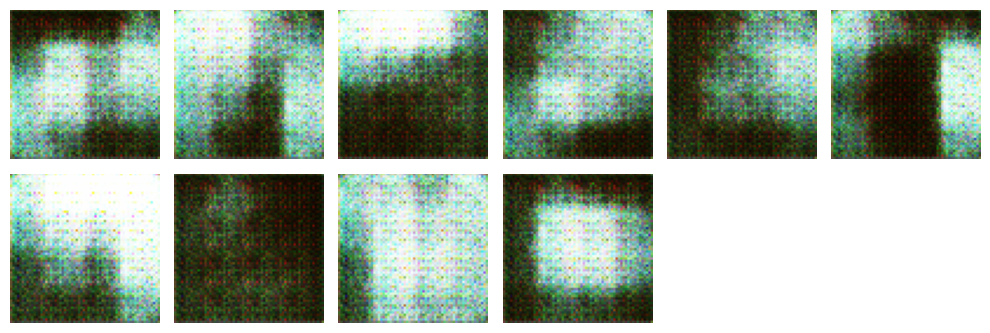

Generator loss: 3.8009486198425293, Discriminator loss: 0.2175815999507904
----
Epoch: 2/30


  0%|          | 0/161 [00:00<?, ?it/s]

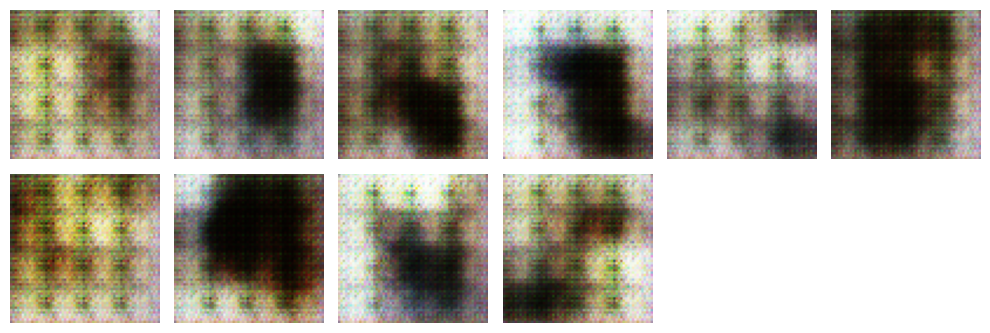

Generator loss: 2.1765542030334473, Discriminator loss: 0.5612370371818542
----
Epoch: 3/30


  0%|          | 0/161 [00:00<?, ?it/s]

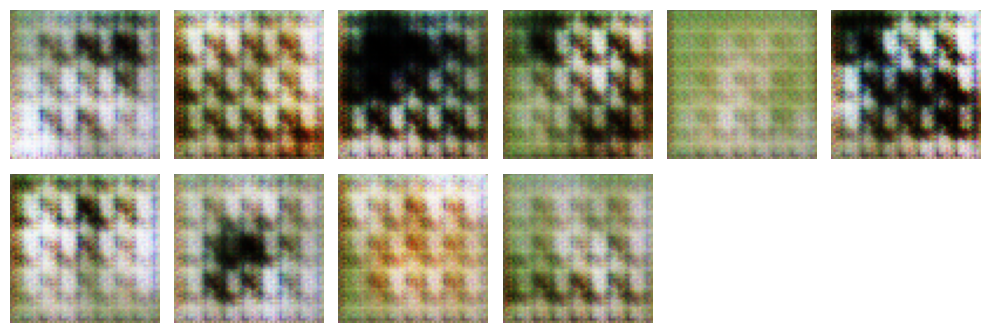

Generator loss: 3.7693727016448975, Discriminator loss: 0.39651158452033997
----
Epoch: 4/30


  0%|          | 0/161 [00:00<?, ?it/s]

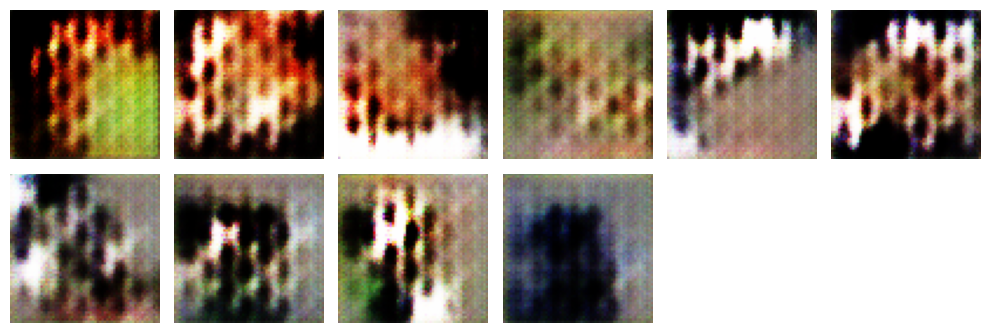

Generator loss: 4.447287559509277, Discriminator loss: 0.7259800434112549
----
Epoch: 5/30


  0%|          | 0/161 [00:00<?, ?it/s]

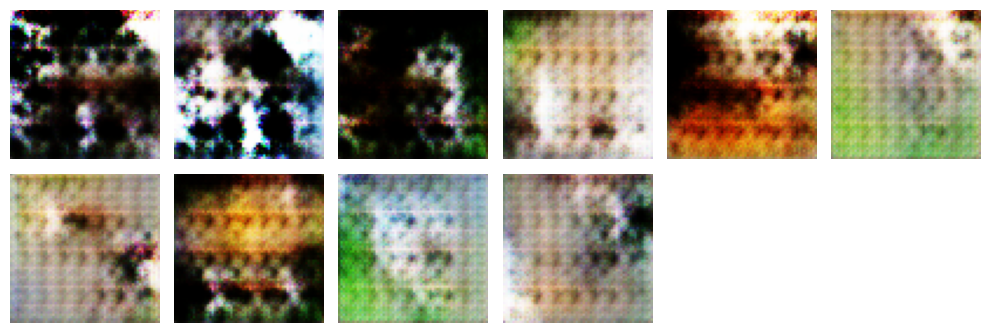

Generator loss: 2.660933494567871, Discriminator loss: 0.5329284071922302
----
Epoch: 6/30


  0%|          | 0/161 [00:00<?, ?it/s]

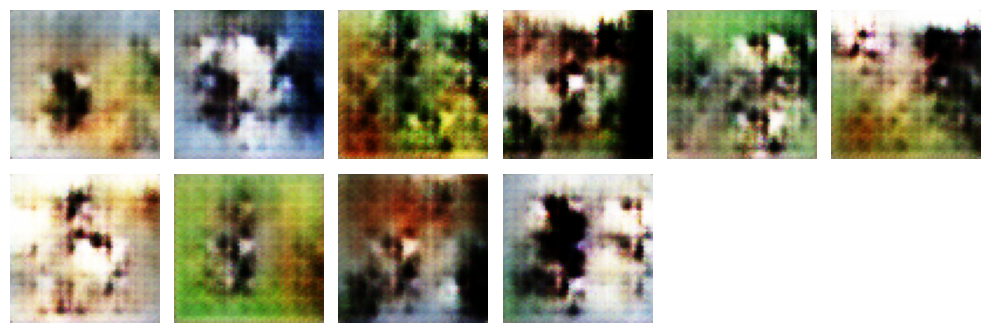

Generator loss: 4.070916175842285, Discriminator loss: 0.6331029534339905
----
Epoch: 7/30


  0%|          | 0/161 [00:00<?, ?it/s]

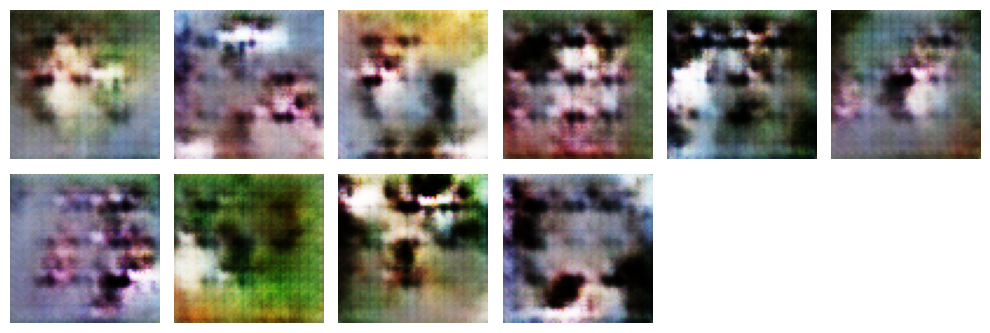

Generator loss: 4.713776588439941, Discriminator loss: 0.6860644817352295
----
Epoch: 8/30


  0%|          | 0/161 [00:00<?, ?it/s]

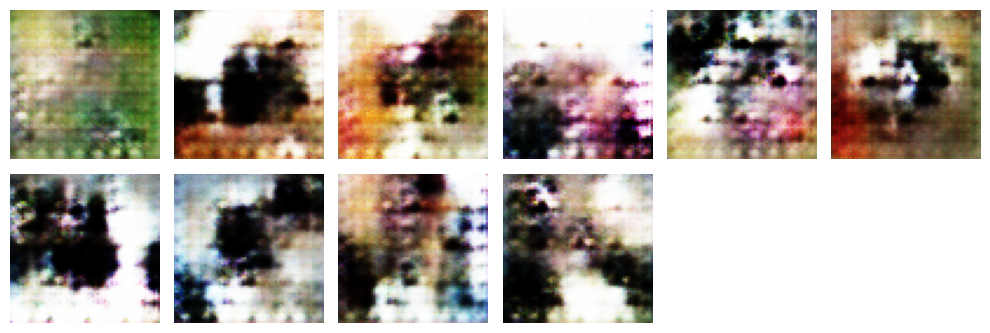

Generator loss: 2.1318111419677734, Discriminator loss: 0.6035028696060181
----
Epoch: 9/30


  0%|          | 0/161 [00:00<?, ?it/s]

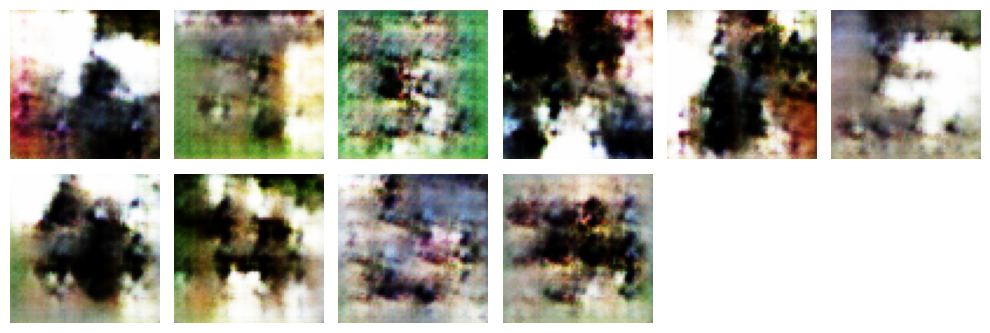

Generator loss: 3.08103609085083, Discriminator loss: 0.5406328439712524
----
Epoch: 10/30


  0%|          | 0/161 [00:00<?, ?it/s]

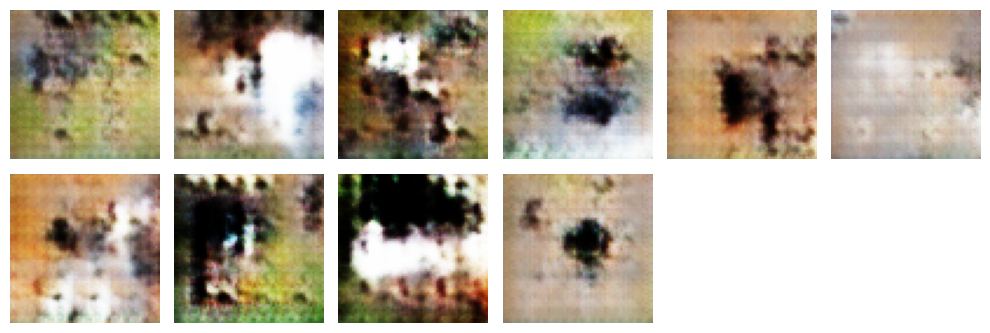

Generator loss: 3.4507484436035156, Discriminator loss: 0.4726325273513794
----
Epoch: 11/30


  0%|          | 0/161 [00:00<?, ?it/s]

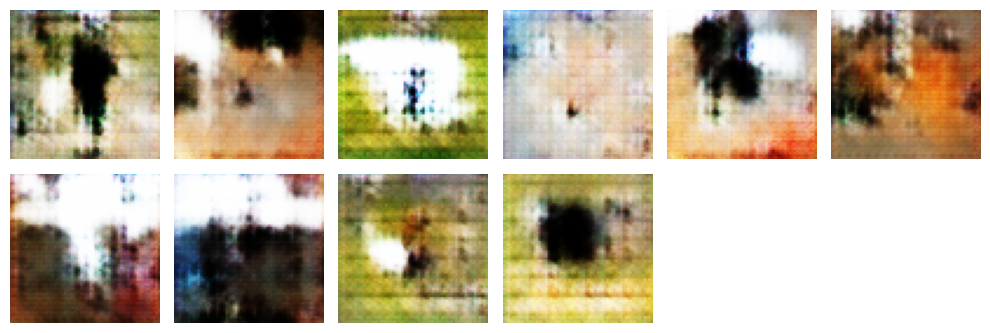

Generator loss: 3.244379997253418, Discriminator loss: 0.17692002654075623
----
Epoch: 12/30


  0%|          | 0/161 [00:00<?, ?it/s]

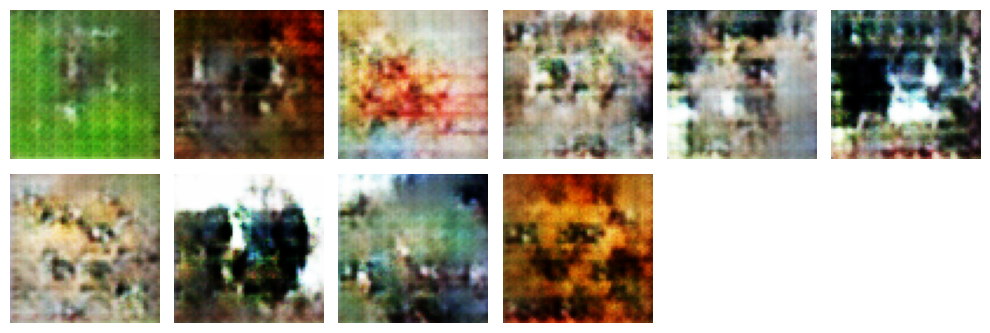

Generator loss: 2.98063325881958, Discriminator loss: 0.7635467052459717
----
Epoch: 13/30


  0%|          | 0/161 [00:00<?, ?it/s]

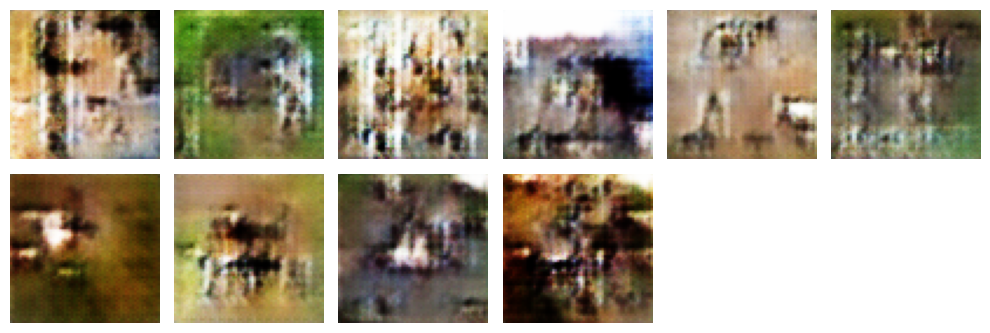

Generator loss: 3.83381986618042, Discriminator loss: 0.51927649974823
----
Epoch: 14/30


  0%|          | 0/161 [00:00<?, ?it/s]

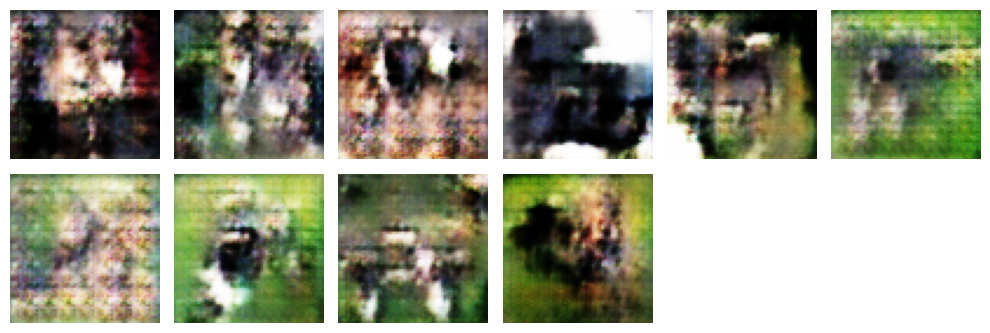

Generator loss: 2.0425093173980713, Discriminator loss: 0.4442736506462097
----
Epoch: 15/30


  0%|          | 0/161 [00:00<?, ?it/s]

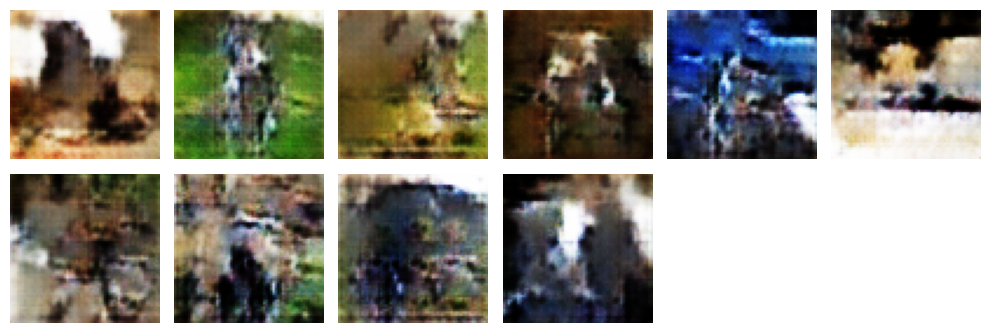

Generator loss: 2.213778018951416, Discriminator loss: 0.7319775223731995
----
Epoch: 16/30


  0%|          | 0/161 [00:00<?, ?it/s]

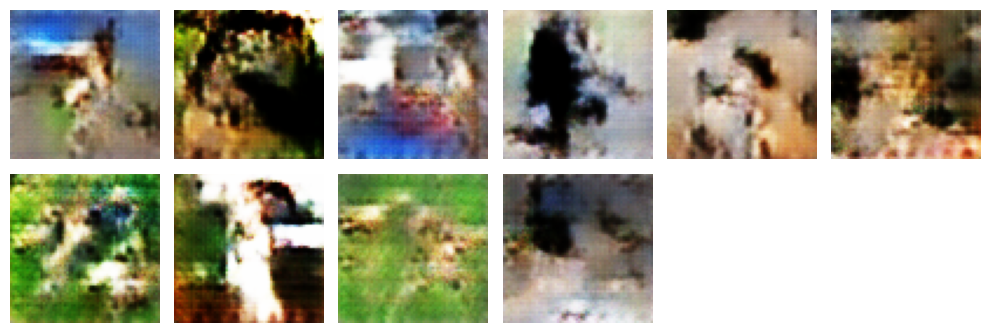

Generator loss: 2.835451126098633, Discriminator loss: 1.0094460248947144
----
Epoch: 17/30


  0%|          | 0/161 [00:00<?, ?it/s]

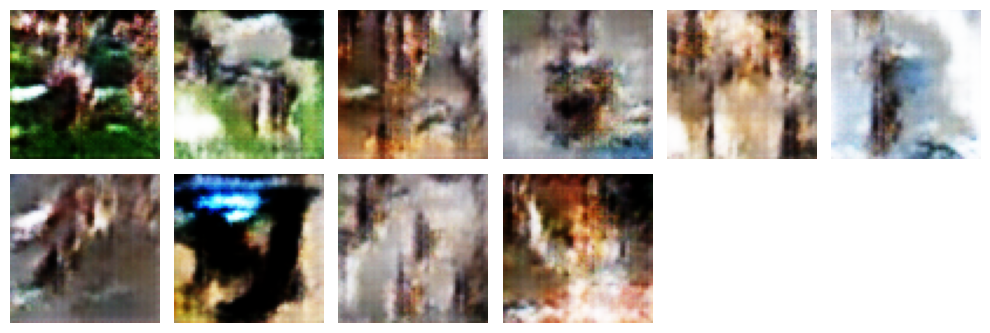

Generator loss: 7.582367420196533, Discriminator loss: 1.198065996170044
----
Epoch: 18/30


  0%|          | 0/161 [00:00<?, ?it/s]

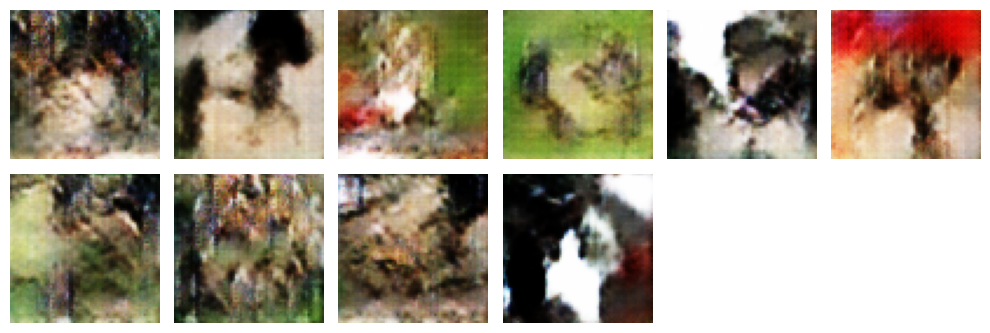

Generator loss: 5.033771991729736, Discriminator loss: 0.6335117816925049
----
Epoch: 19/30


  0%|          | 0/161 [00:00<?, ?it/s]

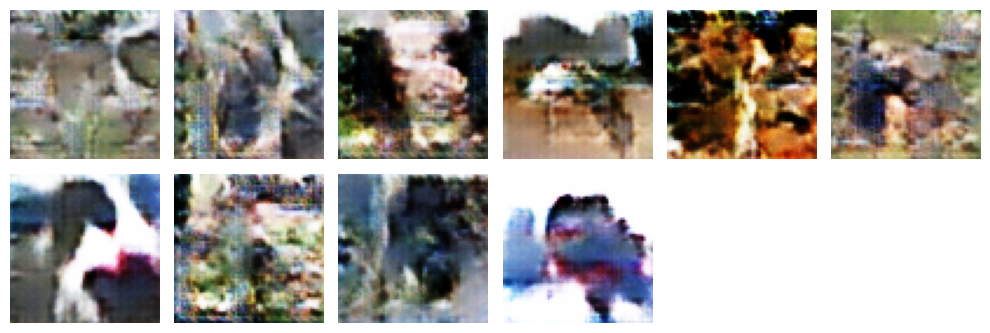

Generator loss: 2.2742857933044434, Discriminator loss: 0.6165218353271484
----
Epoch: 20/30


  0%|          | 0/161 [00:00<?, ?it/s]

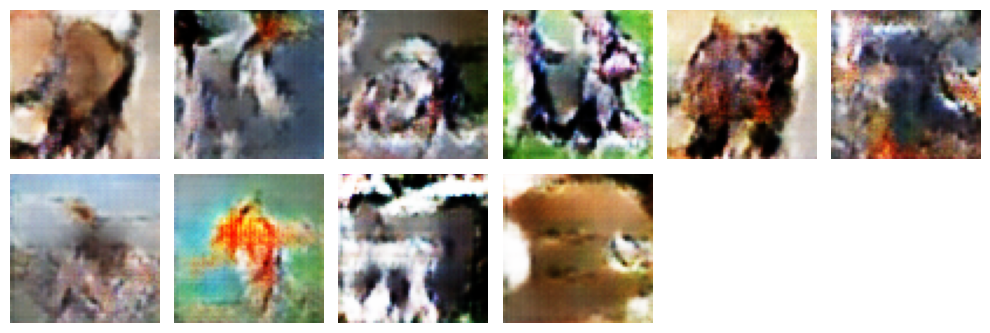

Generator loss: 2.755150556564331, Discriminator loss: 0.38520684838294983
----
Epoch: 21/30


  0%|          | 0/161 [00:00<?, ?it/s]

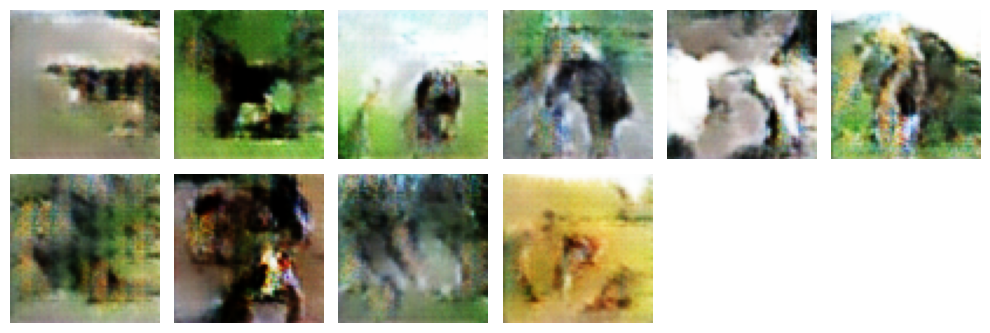

Generator loss: 2.4749090671539307, Discriminator loss: 0.32667917013168335
----
Epoch: 22/30


  0%|          | 0/161 [00:00<?, ?it/s]

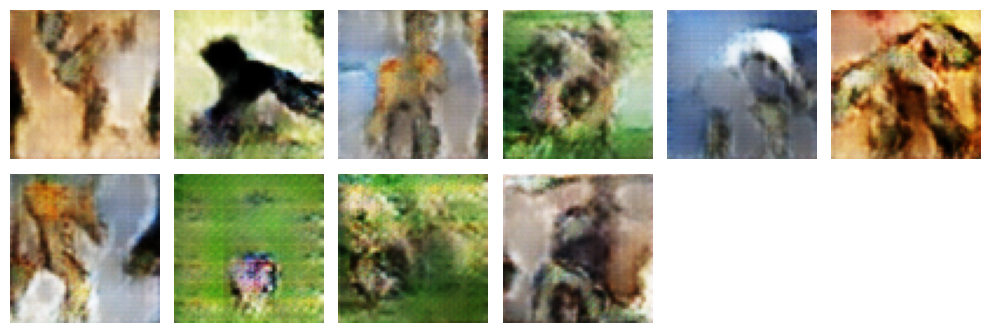

Generator loss: 3.3380250930786133, Discriminator loss: 0.47358080744743347
----
Epoch: 23/30


  0%|          | 0/161 [00:00<?, ?it/s]

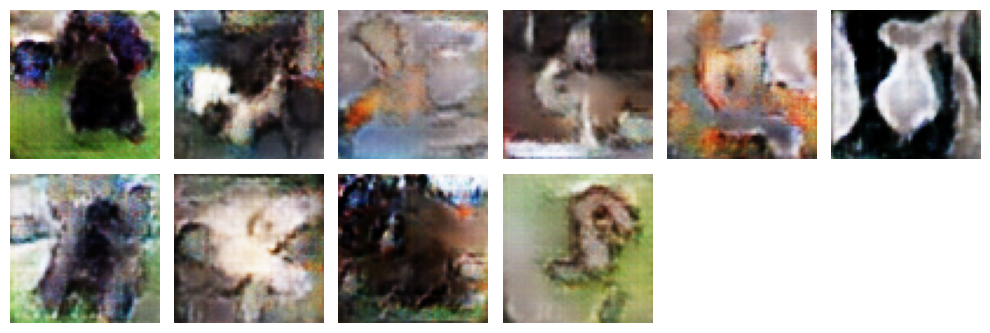

Generator loss: 2.3191728591918945, Discriminator loss: 0.4038997292518616
----
Epoch: 24/30


  0%|          | 0/161 [00:00<?, ?it/s]

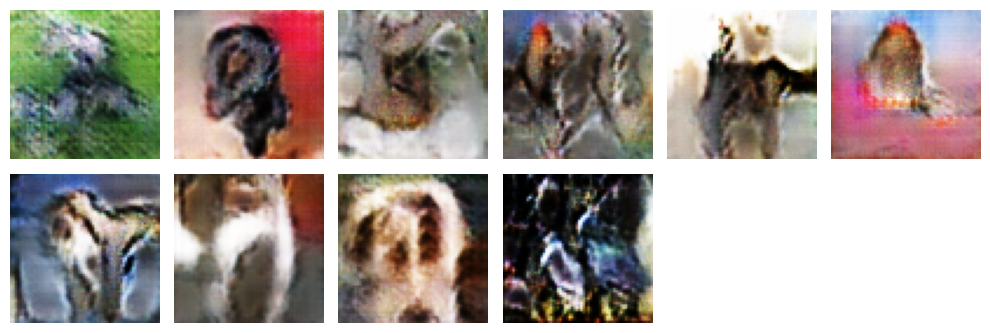

Generator loss: 3.0925252437591553, Discriminator loss: 0.22727090120315552
----
Epoch: 25/30


  0%|          | 0/161 [00:00<?, ?it/s]

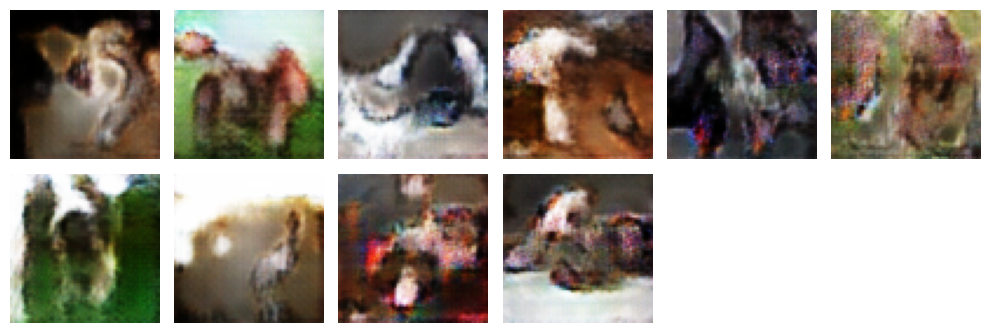

Generator loss: 2.3017024993896484, Discriminator loss: 0.3810727596282959
----
Epoch: 26/30


  0%|          | 0/161 [00:00<?, ?it/s]

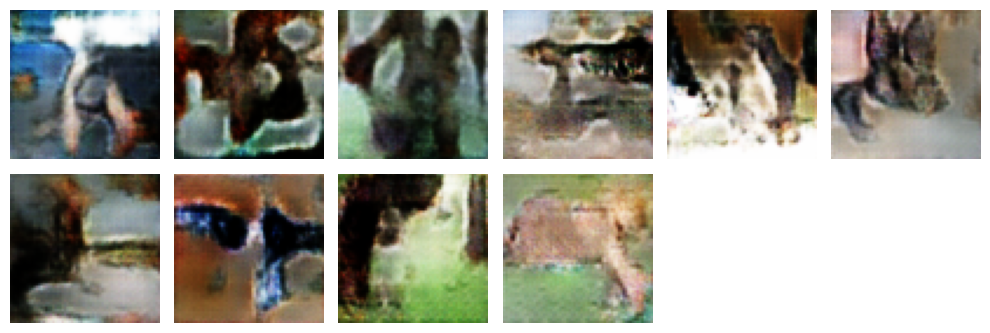

Generator loss: 4.16069221496582, Discriminator loss: 0.3479962944984436
----
Epoch: 27/30


  0%|          | 0/161 [00:00<?, ?it/s]

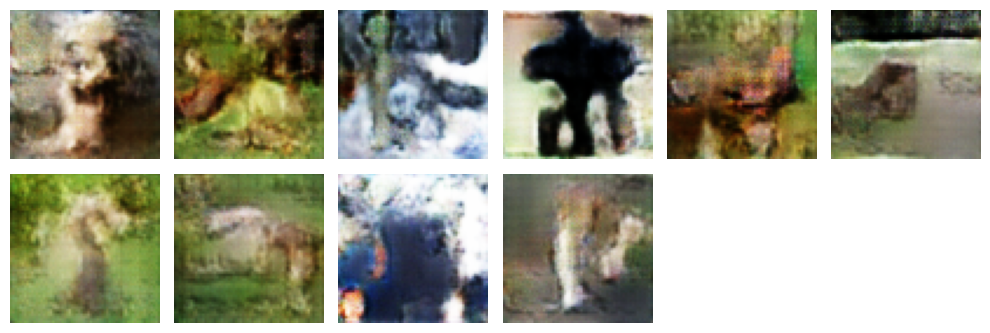

Generator loss: 2.7025234699249268, Discriminator loss: 0.4176342189311981
----
Epoch: 28/30


  0%|          | 0/161 [00:00<?, ?it/s]

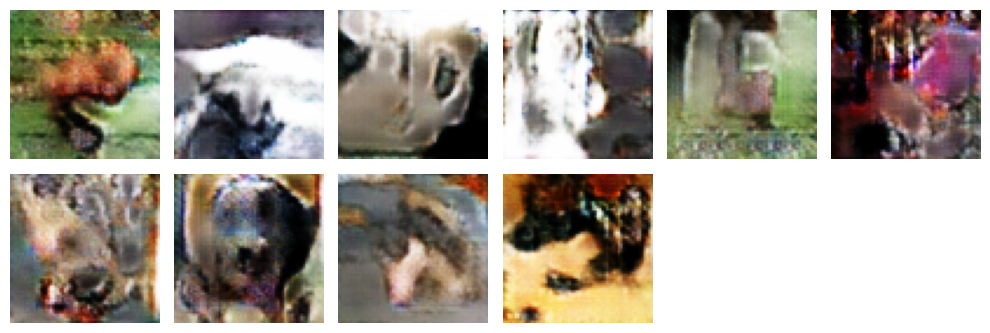

Generator loss: 3.3796443939208984, Discriminator loss: 0.4400708079338074
----
Epoch: 29/30


  0%|          | 0/161 [00:00<?, ?it/s]

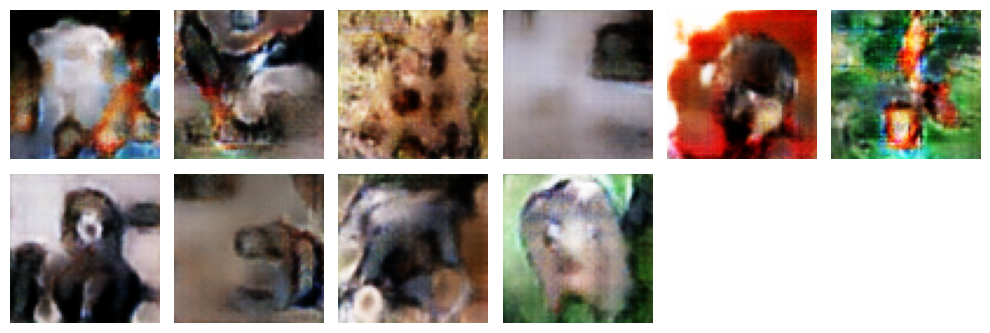

Generator loss: 1.7011903524398804, Discriminator loss: 0.972714900970459
----
Epoch: 30/30


  0%|          | 0/161 [00:00<?, ?it/s]

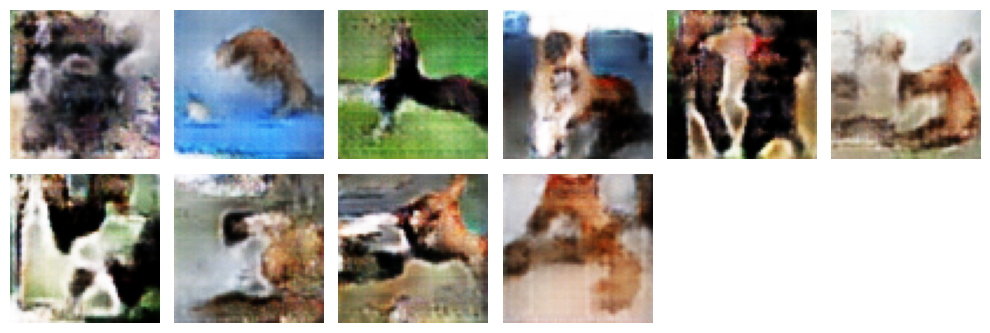

Generator loss: 3.0236663818359375, Discriminator loss: 0.6068456172943115


{'gen_loss': [3.8009486198425293,
  2.1765542030334473,
  3.7693727016448975,
  4.447287559509277,
  2.660933494567871,
  4.070916175842285,
  4.713776588439941,
  2.1318111419677734,
  3.08103609085083,
  3.4507484436035156,
  3.244379997253418,
  2.98063325881958,
  3.83381986618042,
  2.0425093173980713,
  2.213778018951416,
  2.835451126098633,
  7.582367420196533,
  5.033771991729736,
  2.2742857933044434,
  2.755150556564331,
  2.4749090671539307,
  3.3380250930786133,
  2.3191728591918945,
  3.0925252437591553,
  2.3017024993896484,
  4.16069221496582,
  2.7025234699249268,
  3.3796443939208984,
  1.7011903524398804,
  3.0236663818359375],
 'dics_loss': [0.2175815999507904,
  0.5612370371818542,
  0.39651158452033997,
  0.7259800434112549,
  0.5329284071922302,
  0.6331029534339905,
  0.6860644817352295,
  0.6035028696060181,
  0.5406328439712524,
  0.4726325273513794,
  0.17692002654075623,
  0.7635467052459717,
  0.51927649974823,
  0.4442736506462097,
  0.7319775223731995,
  

In [ ]:
trainer.fit(epochs)

----
Epoch: 31/80


  0%|          | 0/161 [00:00<?, ?it/s]

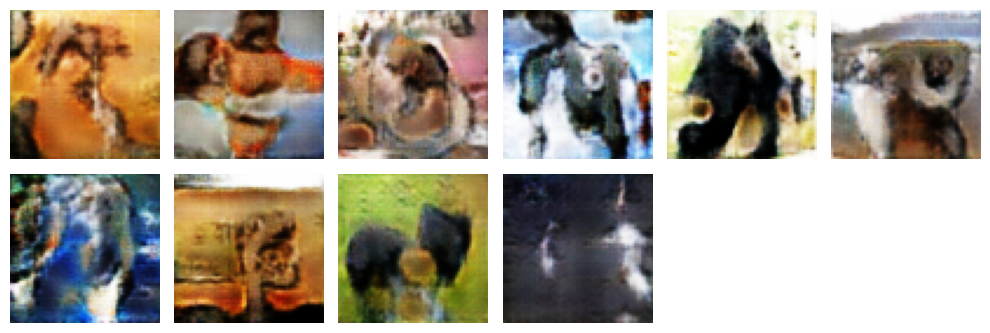

Generator loss: 2.7804532051086426, Discriminator loss: 0.3233078718185425
----
Epoch: 32/80


  0%|          | 0/161 [00:00<?, ?it/s]

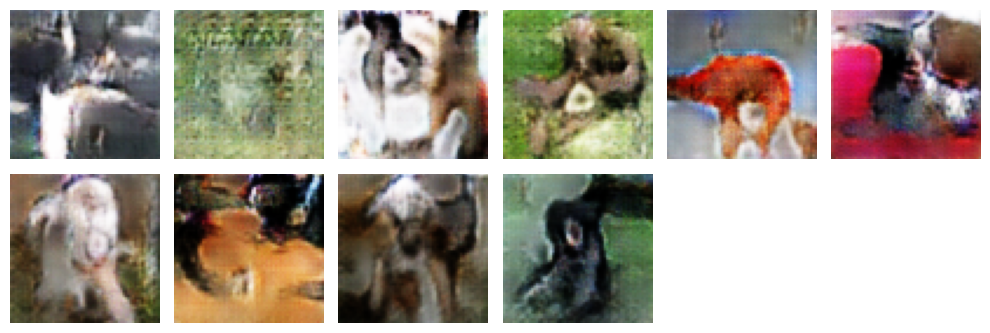

Generator loss: 4.435847282409668, Discriminator loss: 0.5287140011787415
----
Epoch: 33/80


  0%|          | 0/161 [00:00<?, ?it/s]

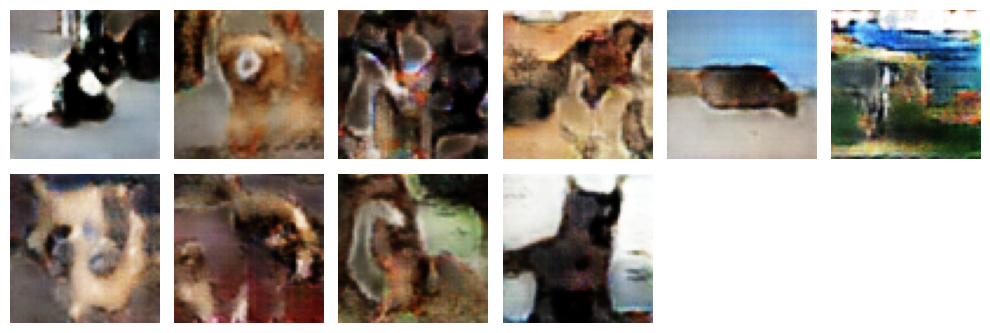

Generator loss: 2.7733547687530518, Discriminator loss: 0.34114590287208557
----
Epoch: 34/80


  0%|          | 0/161 [00:00<?, ?it/s]

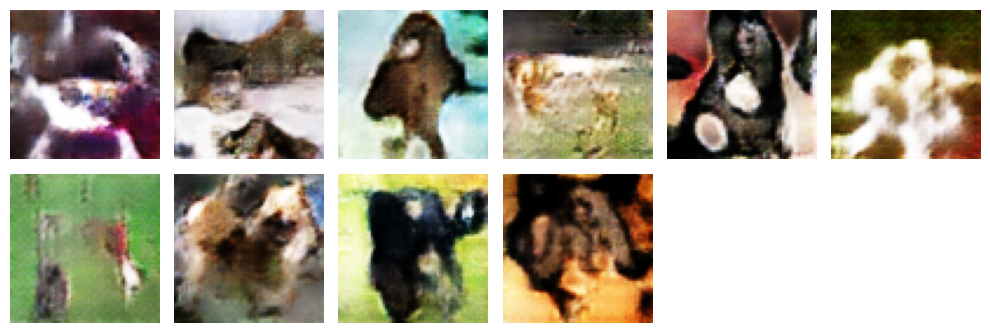

Generator loss: 1.9978022575378418, Discriminator loss: 0.6631038784980774
----
Epoch: 35/80


  0%|          | 0/161 [00:00<?, ?it/s]

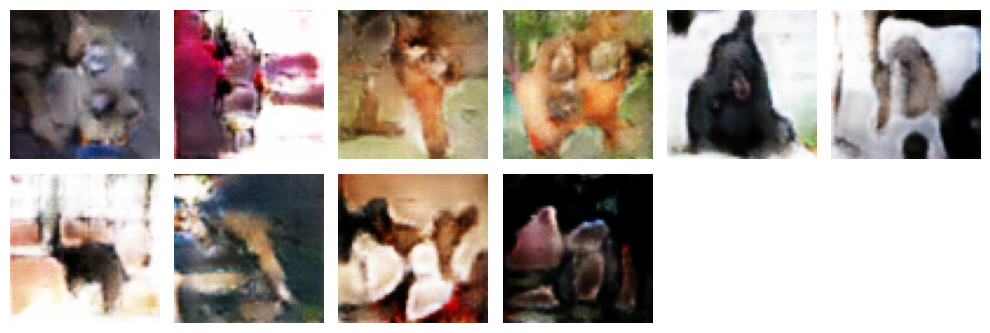

Generator loss: 2.767617702484131, Discriminator loss: 0.3466048240661621
----
Epoch: 36/80


  0%|          | 0/161 [00:00<?, ?it/s]

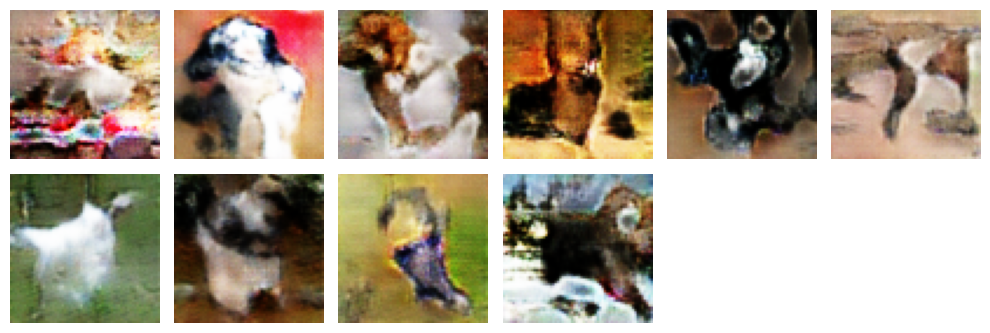

Generator loss: 3.5245914459228516, Discriminator loss: 0.4893677830696106
----
Epoch: 37/80


  0%|          | 0/161 [00:00<?, ?it/s]

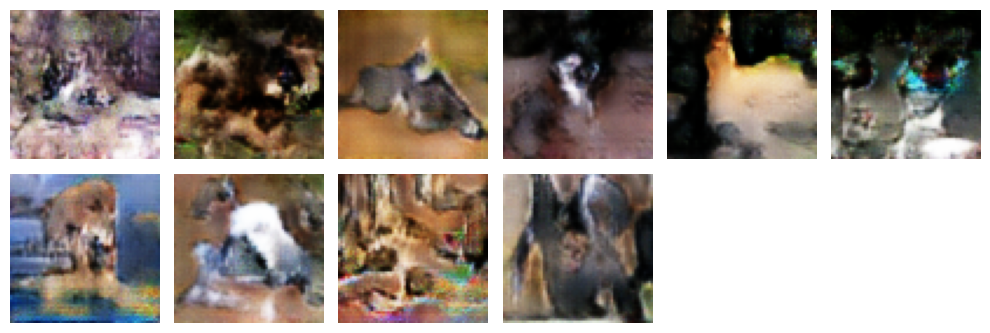

Generator loss: 4.743005752563477, Discriminator loss: 0.3592596650123596
----
Epoch: 38/80


  0%|          | 0/161 [00:00<?, ?it/s]

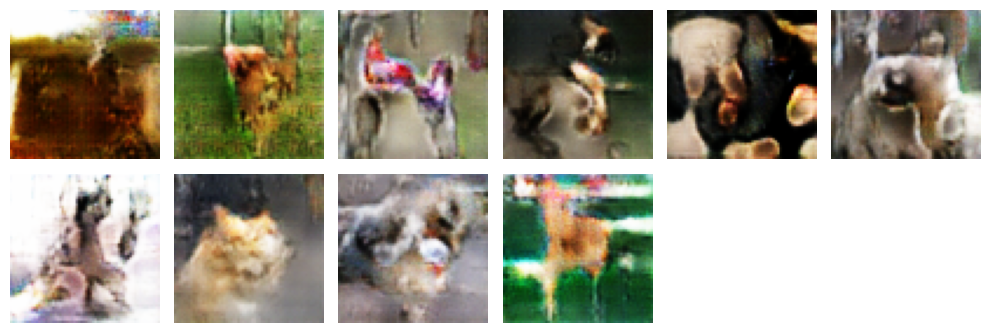

Generator loss: 3.748018741607666, Discriminator loss: 0.2863676846027374
----
Epoch: 39/80


  0%|          | 0/161 [00:00<?, ?it/s]

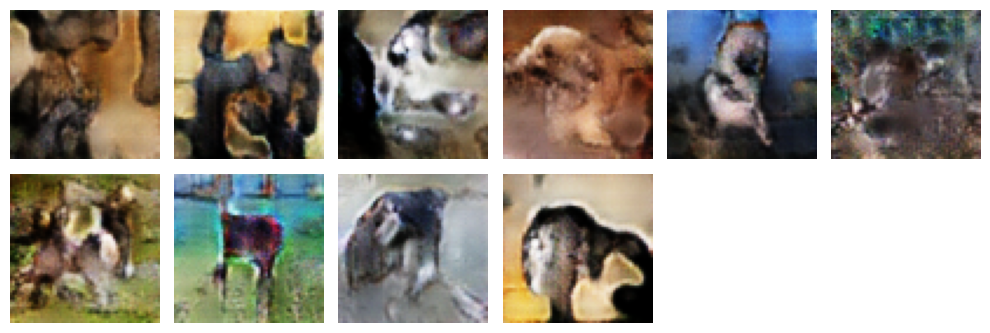

Generator loss: 1.9014191627502441, Discriminator loss: 0.27889350056648254
----
Epoch: 40/80


  0%|          | 0/161 [00:00<?, ?it/s]

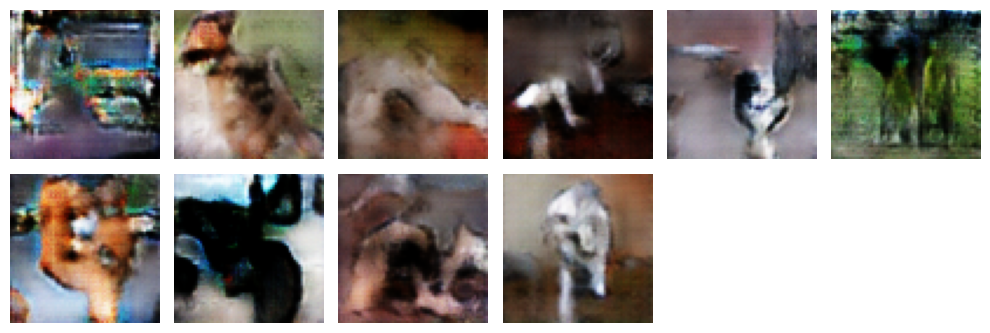

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Generator loss: 5.2680134773254395, Discriminator loss: 1.1009814739227295
----
Epoch: 41/80


  0%|          | 0/161 [00:00<?, ?it/s]

In [ ]:
# training for longer periods of time
history = trainer.fit(80, create_dir=False, start_idx=30, save_after=10)

# 7. Save and download model and pictures

## 7.1 Save models

In [ ]:
generator_model_path = "models/generator"
discriminator_model_path = "models/discriminator"

In [ ]:
os.makedirs(generator_model_path, exist_ok=True)
os.makedirs(discriminator_model_path, exist_ok=True)

In [ ]:
torch.save(generator.state_dict(), f"{generator_model_path}/generator.h5")
torch.save(discriminator.state_dict(), f"{discriminator_model_path}/discriminator.h5")

## 7.2 Download models and pictures
We will zip the models folder and then just download it from the colab filesystem

In [ ]:
!zip -r models.zip models

  adding: models/ (stored 0%)
  adding: models/generator/ (stored 0%)
  adding: models/generator/generator.h5 (deflated 7%)
  adding: models/discriminator/ (stored 0%)
  adding: models/discriminator/discriminator.h5 (deflated 8%)
